In [1]:
from itertools import islice
import random as rnd
from src.estimate_watermark import *
from src.preprocess import *
from src.image_getter import *
from src.watermark_reconstruct import *

wm_type = 'ci'
source = 'cian'
dir_images = f'./dataset/{source}'
res_dir = f'./dataset/{source}_' + str(''.join(rnd.choice('qwertyuiopasdfghjkl') for i in range(4)))  # + '/cropped'
files_number = 25
image_size = 1280

if not os.path.isdir(dir_images):
    os.mkdir(dir_images)

files = os.listdir(dir_images)

if len(files) == 0:
    photo_scrape(dir_images, files_number, wm_type)
else:
    print("All files downloaded")

All files downloaded


In [44]:
wm_detector_low_thr = 80
wm_detector_high_thr = 100
wm_crop_trh = 0.05

In [45]:
J = read_images(dir_images)

images = preprocess(J, image_size)
# images.update(preprocess(J, image_size, 'constant'))

Wm_x, Wm_y, num_images = estimate_watermark(images)

# crop watermark area and get cropped gradient
cropped_Wm_x, cropped_Wm_y = crop_watermark_ignore_borders(Wm_x, Wm_y,
                                                           threshold=wm_crop_trh)

Computing images gradients.
Computing median gradients.


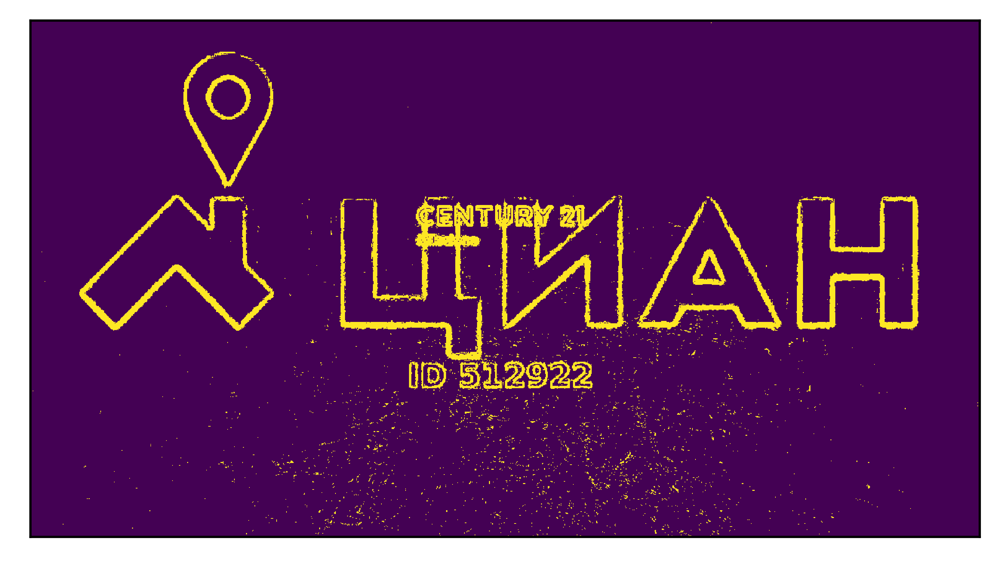

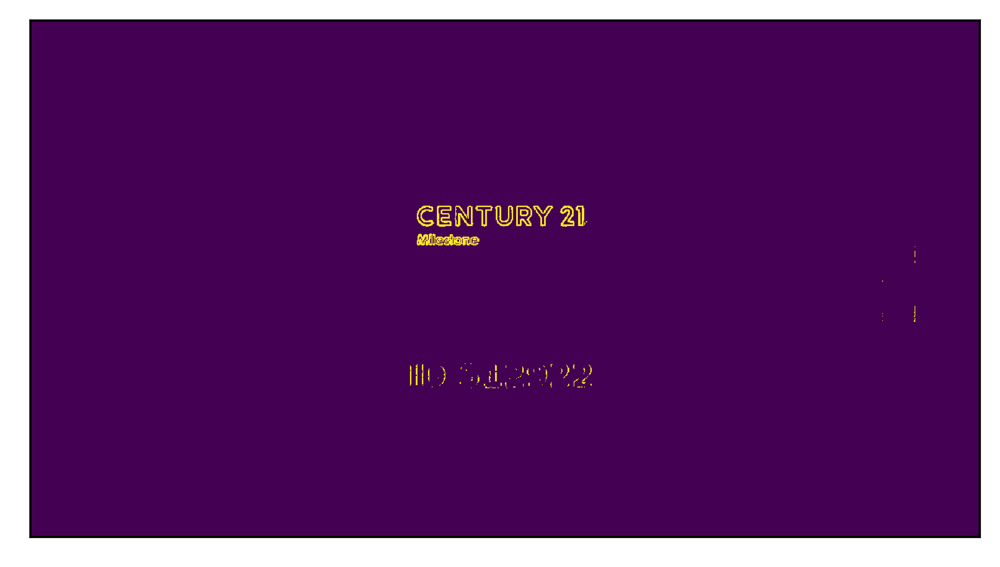

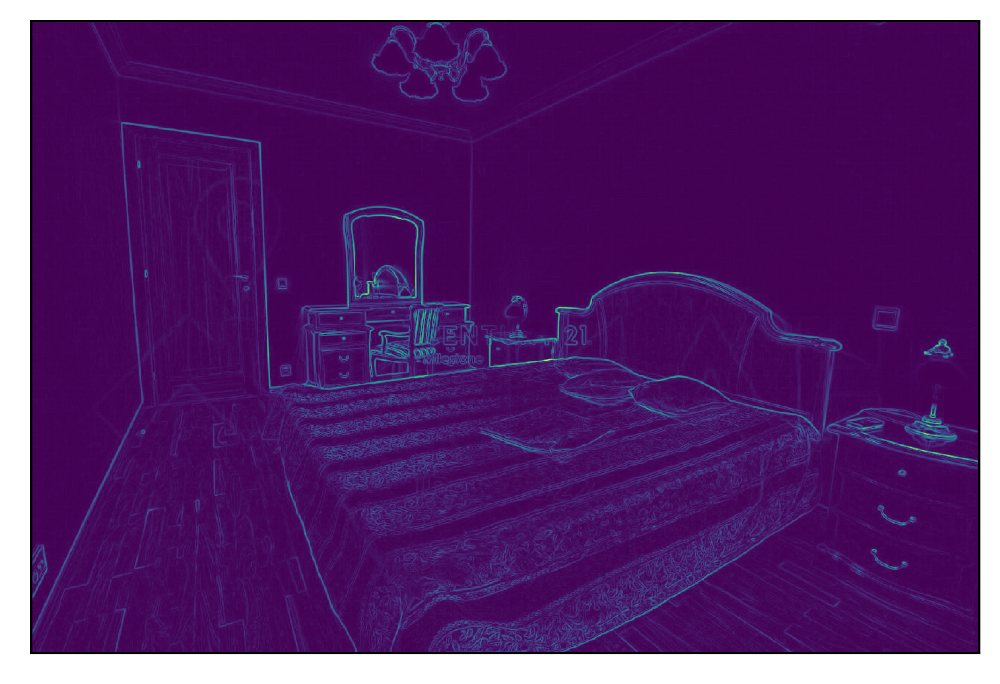

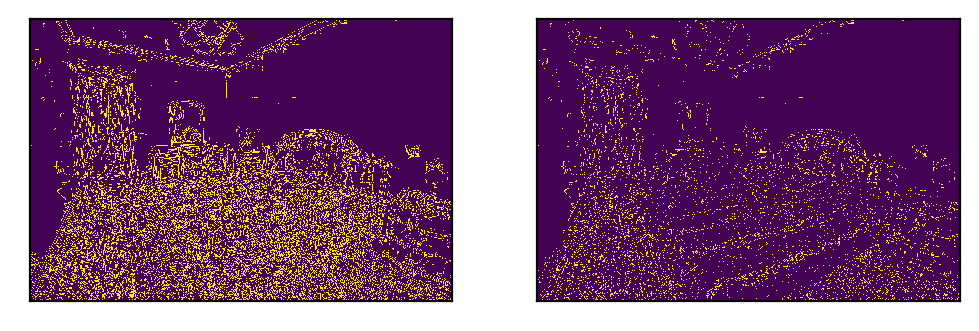

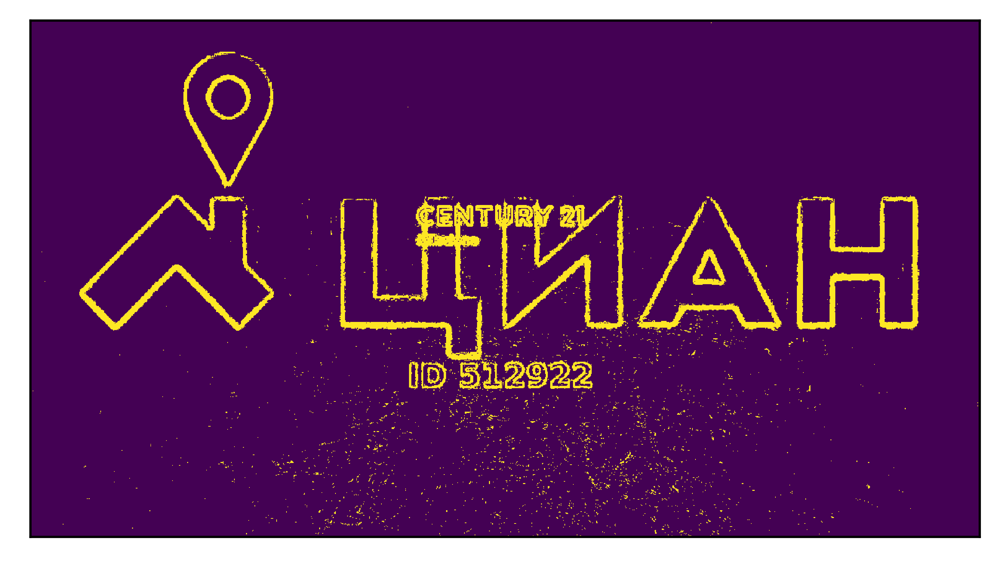

...

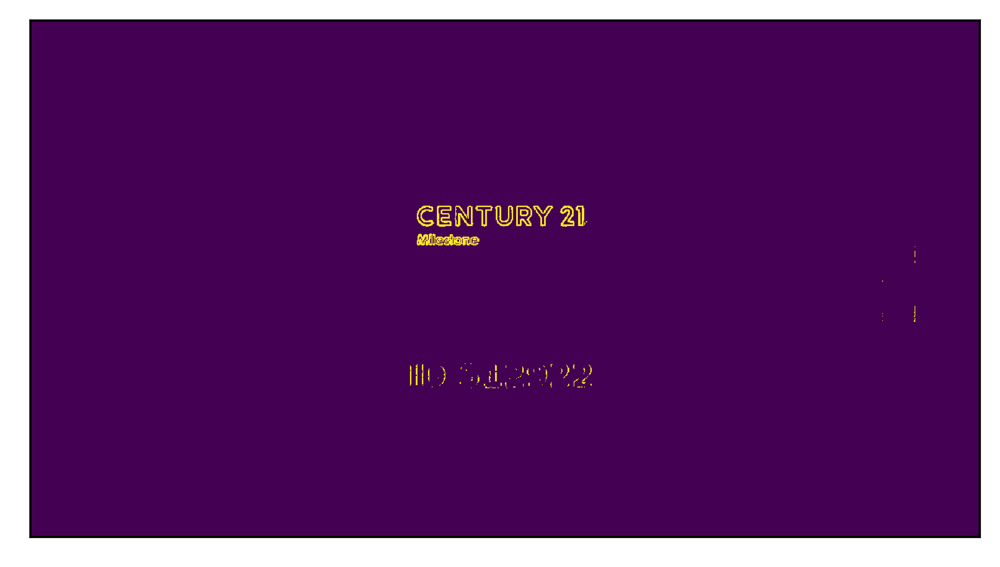

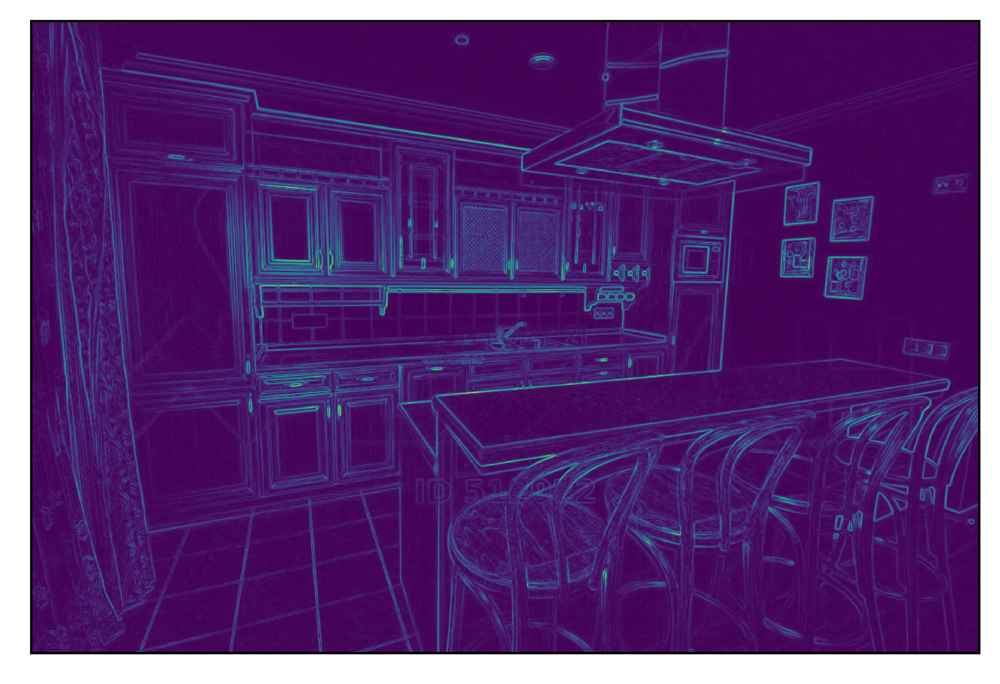

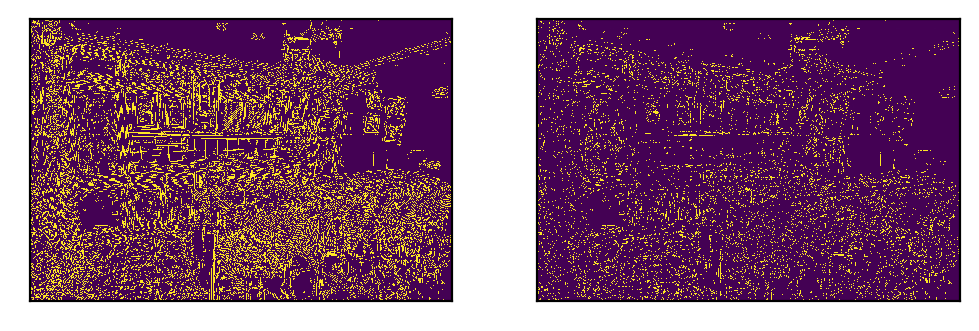

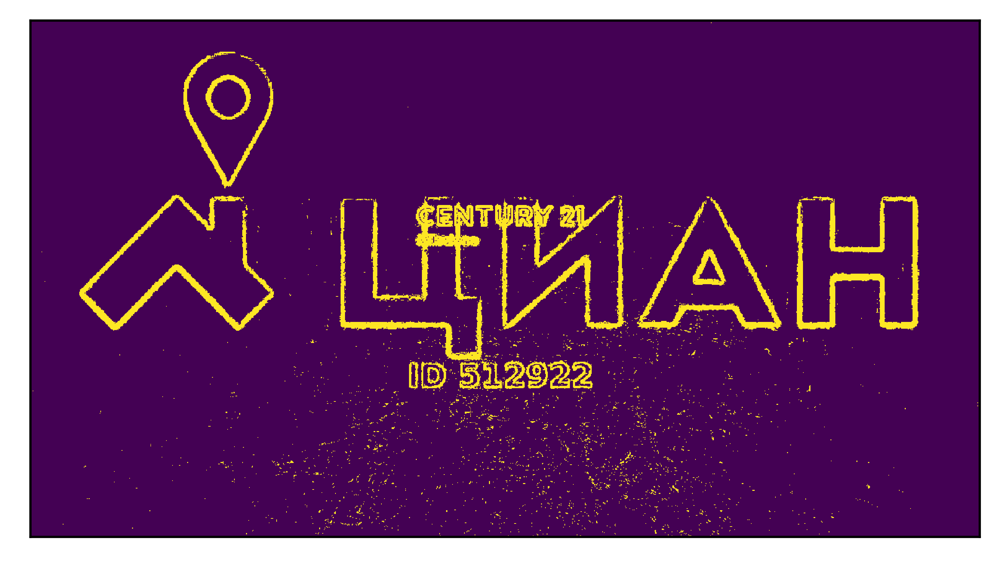

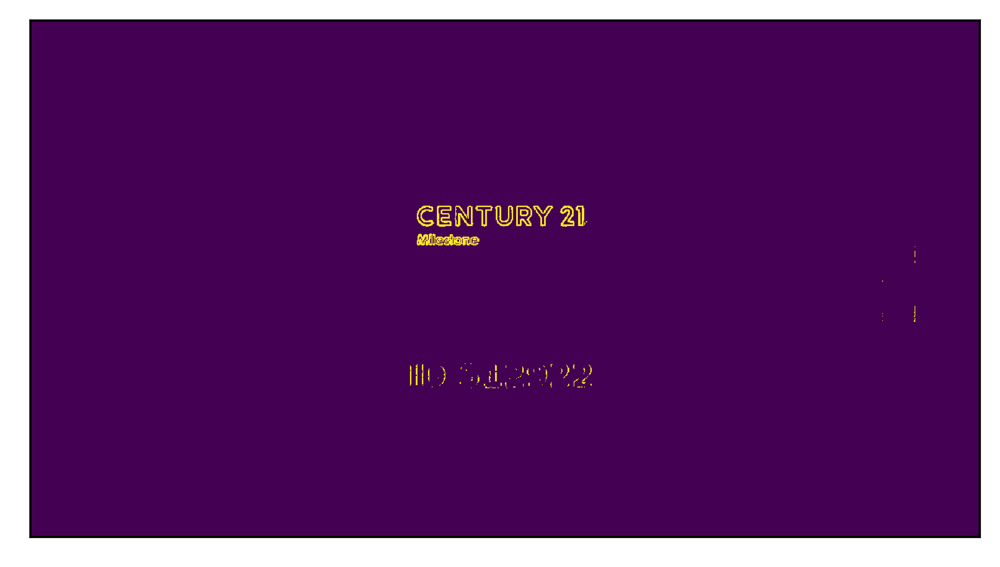

In [ ]:
res = get_cropped_images(dict(islice(J.items(), 3)), cropped_Wm_x, cropped_Wm_y,
                       thresh_low=10,
                       thresh_high=30)

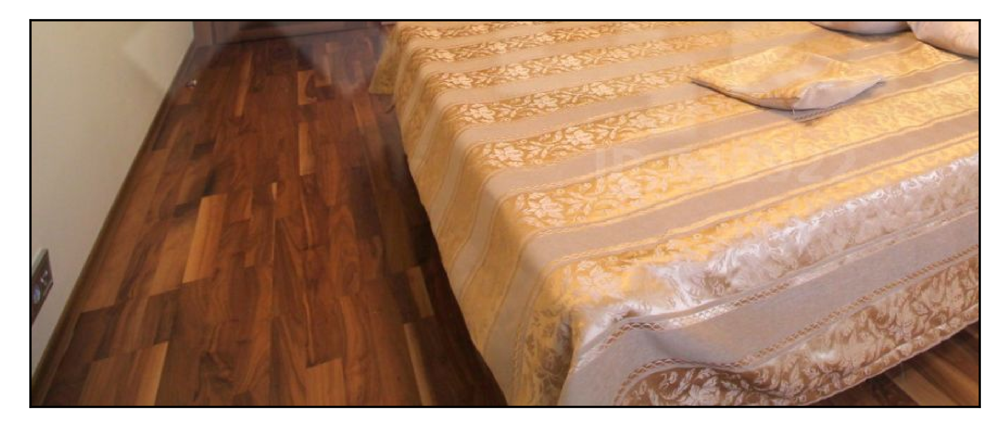

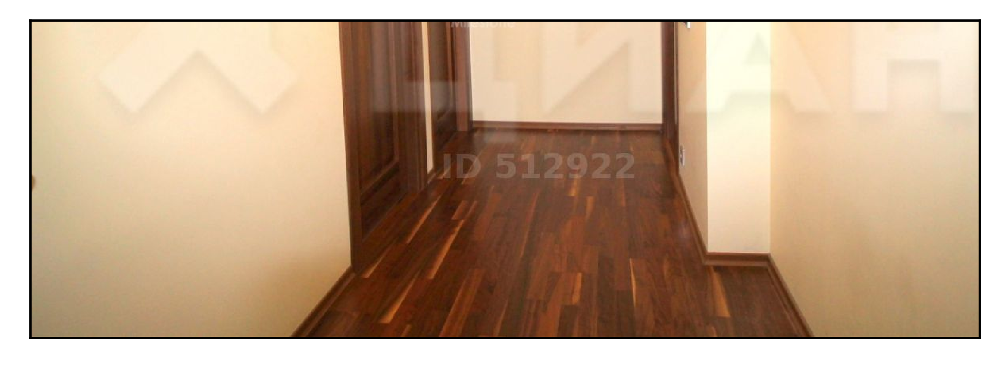

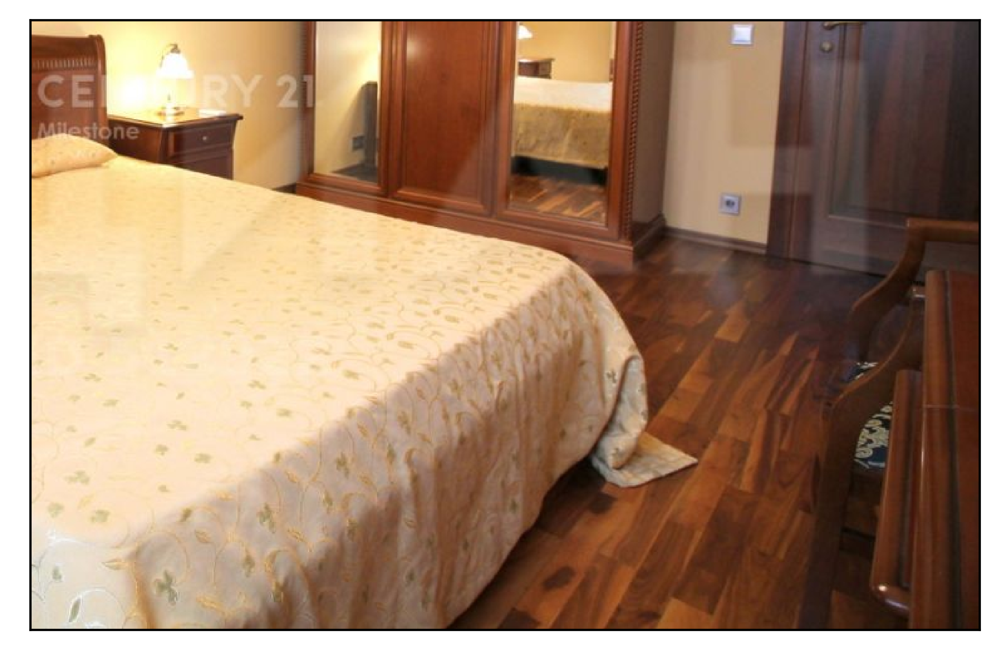

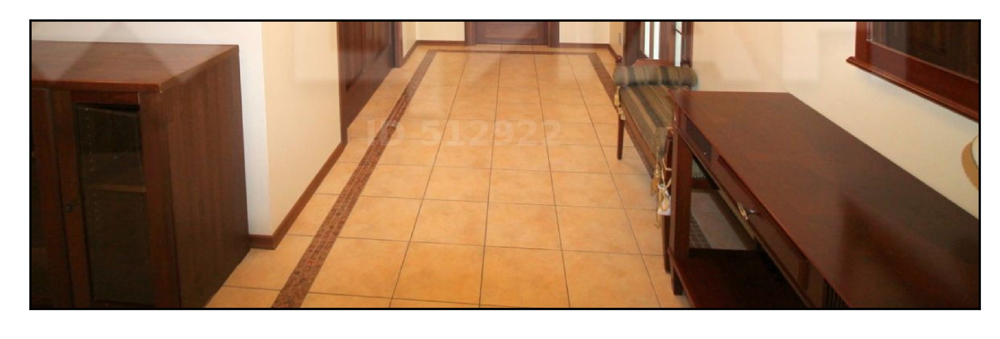

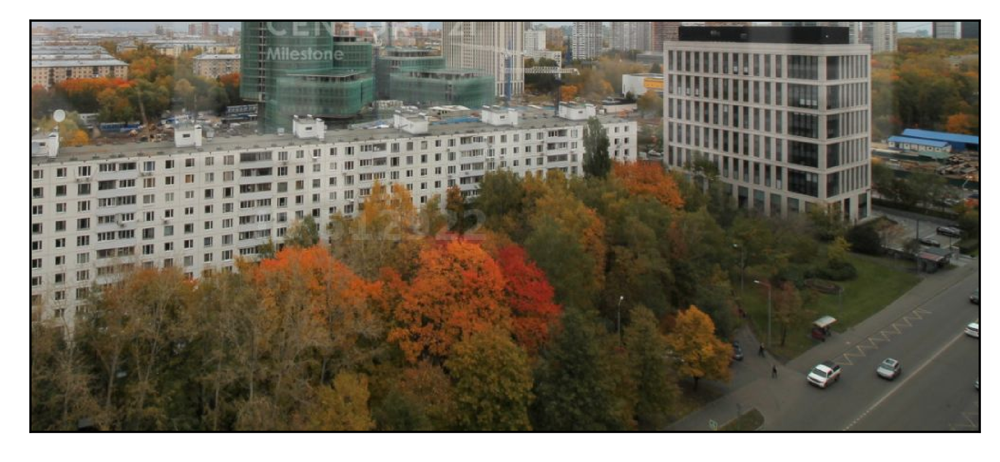

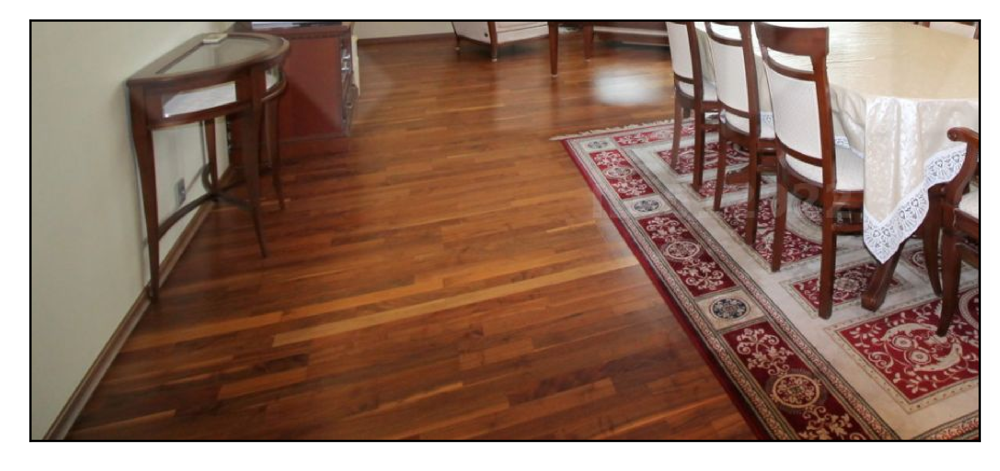

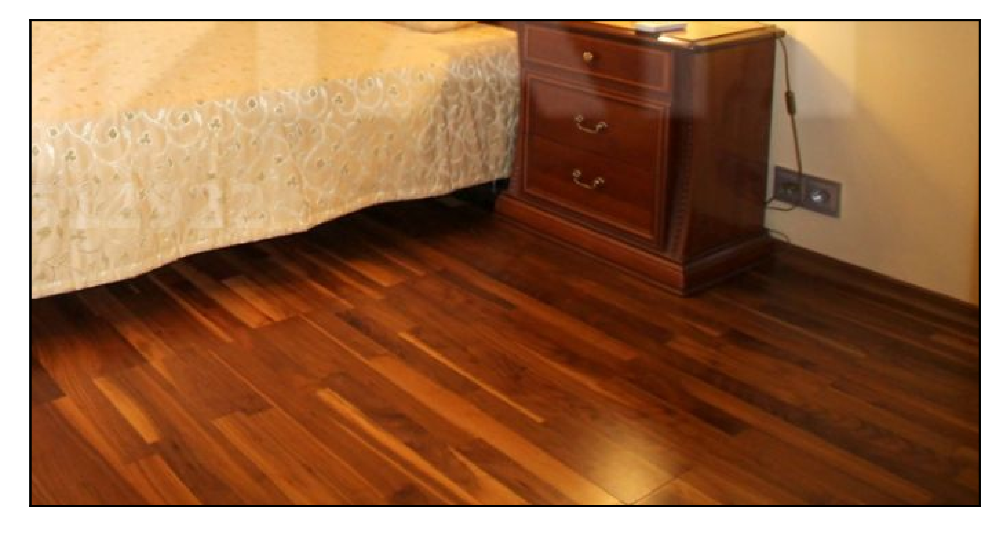

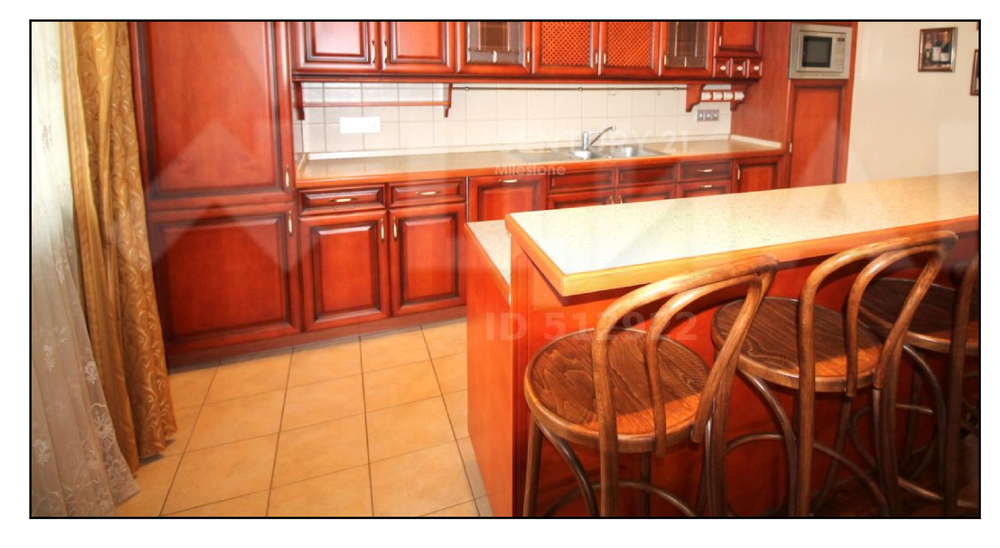

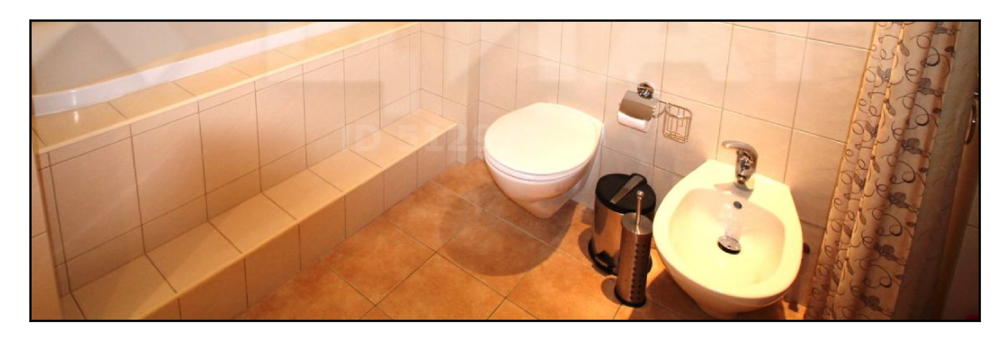

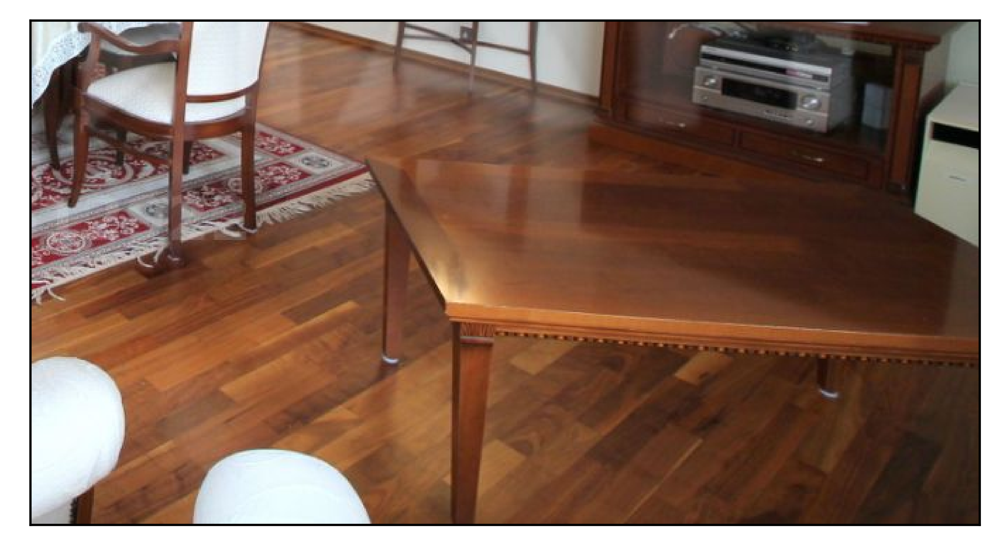

In [77]:
plot_images([im for im in list(res.values())])

In [78]:
def watermark_detector(img, gx, gy, thresh_low=200, thresh_high=220, printval=False):
    """
    Compute a verbose edge map using Canny edge detector, take its magnitude.
    Assuming cropped values of gradients are given.
    Returns images, start and end coordinates
    """
    Wm = (np.average(np.sqrt(np.square(gx) + np.square(gy)), axis=2))
    Wm = threshold_image(Wm, threshold=0.05)
    plot_images([Wm], False)
    
    img_x = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=KERNEL_SIZE)
    img_y = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=KERNEL_SIZE)
    img_g = Wm = (np.average(np.sqrt(np.square(img_x) + np.square(img_y)), axis=2))
    plot_images([img_g], False)
    img_g = threshold_image(img_g, threshold=0.05)

    img_edgemap1 = (cv2.Canny(img[:,:,0], thresh_low, thresh_high))
    img_edgemap = img_edgemap1 - (cv2.Canny(img, 30, 30))
    chamfer_dist = cv2.filter2D(img_edgemap.astype(float), -1, Wm)

    if printval:
        plt.figure(dpi=200)
        plt.subplot(1, 2, 1)
        plt.imshow(to_plot_normalize_image(img_edgemap1))
        plt.xticks([]), plt.yticks([])
        plt.subplot(1, 2, 2)
        plt.imshow(to_plot_normalize_image(img_edgemap))
        plt.xticks([]), plt.yticks([])
        plt.draw()
        plt.pause(0.001)

    rect = Wm.shape
    index = np.unravel_index(np.argmax(chamfer_dist), img.shape[:-1])

    x, y = int(index[0] - rect[0] / 2), int(index[1] - rect[1] / 2)  # Must be an integer, so make adjustments
    im = img.copy()
    cv2.rectangle(im, (y, x), (y + rect[1], x + rect[0]), (255, 0, 0))

    return im, (x, y), (rect[0], rect[1])

def get_cropped_images(images, cropped_Wm_x, cropped_Wm_y, thresh_low=200, thresh_high=220):
    """
    This is the part where we get all the images, extract their parts, and then add it to our matrix
    """
    # images_cropped = np.zeros((num_images,) + shape)
    images_cropped = {}

    for file, img in images.items():
        img_marked, wm_start, wm_end = watermark_detector(img, cropped_Wm_x, cropped_Wm_y,
                                                          thresh_low=thresh_low,
                                                          thresh_high=thresh_high,
                                                          printval=True)
        img_result = img[max(wm_start[0], 0):wm_start[0] + wm_end[0], max(wm_start[1], 0):wm_start[1] + wm_end[1], :]

        if not img_result.any():
            continue

        images_cropped[file] = img_result

        # images_cropped[index, :, :, :] = _img

    return images_cropped